In [1]:
import anndata as ad
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

from scipy.stats import pearsonr
from scipy.stats import spearmanr
from scipy.stats import stats
from scipy.spatial.distance import squareform
from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list, fcluster

import seaborn as sns
import gseapy as gp
import matplotlib.colors as mcolors

In [2]:
fdata = ad.read_h5ad("./RNA/Multitime.clustered.h5")
cdata = ad.read_h5ad("./RNA/Multitime.guide.h5")

In [3]:
fdata_2 = fdata[fdata.obs["time_point"] == "2"].copy()
cdata_2 = cdata[cdata.obs["time_point"] == "2"].copy()

In [12]:
np.sum([(x[0] == y[0]) & (x[1] == y[1]) for x, y in zip(fdata.obsm["spatial"], cdata.obsm["spatial"])])

66509

# major_clone

In [3]:
threshold = np.quantile(cdata.X.toarray(), 0.9995)
threshold

12.0

In [14]:
count_major = {}
for guide in cdata.var_names:
    count_major[guide] = cdata[cdata[:, guide].X > threshold].shape[0]
count_major = pd.DataFrame(count_major, index=["number_of_bins"])

<Figure size 1000x800 with 0 Axes>

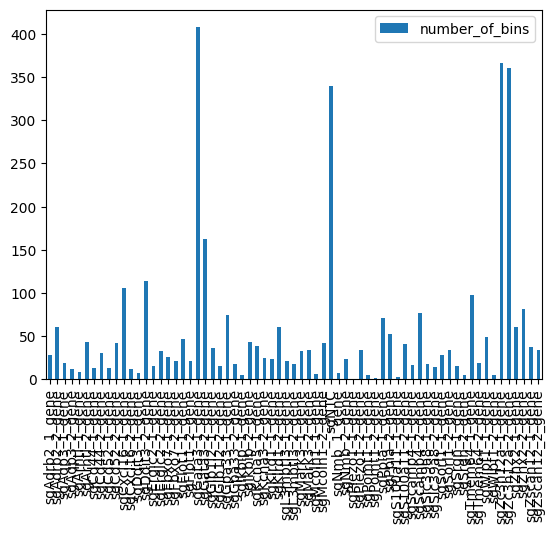

In [15]:
plt.figure(figsize=(10, 8))
count_major.T.plot(kind="bar")
plt.show()

In [4]:
def clean_guide_data(rnadata, guidedata):

    rnadata.obs["cov"] = [str(marker) + '_' + str(array[0]) + "-" + str(array[1]) for marker, array in zip(rnadata.obs["marker"], rnadata.obsm["spatial"])]
    guidedata.obs["cov"] = [str(marker) + '_' + str(array[0]) + "-" + str(array[1]) for marker, array in zip(guidedata.obs["marker"], guidedata.obsm["spatial"])]

    common_cov = np.intersect1d(rnadata.obs['cov'], guidedata.obs['cov'])
    guidedata.obs_names = guidedata.obs['cov']
    rnadata.obs_names = rnadata.obs['cov']

    guidedata_filtered = guidedata[common_cov].copy()
    sorted_obs_names = rnadata.obs_names.sort_values()
    guidedata_filtered = guidedata_filtered[sorted_obs_names].copy()
    rnadata = rnadata[sorted_obs_names].copy()
    missing_cov = rnadata.obs['cov'][~rnadata.obs['cov'].isin(common_cov)]
    if len(missing_cov) > 0:
        missing_obs = pd.DataFrame({'marker': [cov.split('_')[0] for cov in missing_cov]}, index=missing_cov)
        missing_obsm_spatial = np.array([[float(cov.split('_')[1].split('-')[0]), float(cov.split('_')[1].split('-')[1])] for cov in missing_cov])
        missing_X = np.zeros((len(missing_cov), guidedata.shape[1]))  # 假设 guidedata 和 rnadata 的 shape[1] 相同

        missing_guidedata = ad.AnnData(X=missing_X, obs=missing_obs, obsm={'spatial': missing_obsm_spatial})
        guidedata_filtered = guidedata_filtered.concatenate(missing_guidedata)
    return rnadata, guidedata_filtered

In [5]:
fdata, cdata = clean_guide_data(fdata, cdata)

In [100]:
proportion_df = {}
for guide in cdata.var_names:
    mask = (cdata[:, guide].X > threshold)
    proportion_df[guide] = (fdata[mask].obs["cluster_cellcharter_givenk"]).value_counts()
proportion_df = pd.DataFrame(proportion_df)
proportion_df = proportion_df.T.fillna(0)

proportion_df = (proportion_df.T / proportion_df.T.sum(axis=0)).T
proportion_df.dropna(inplace=True)

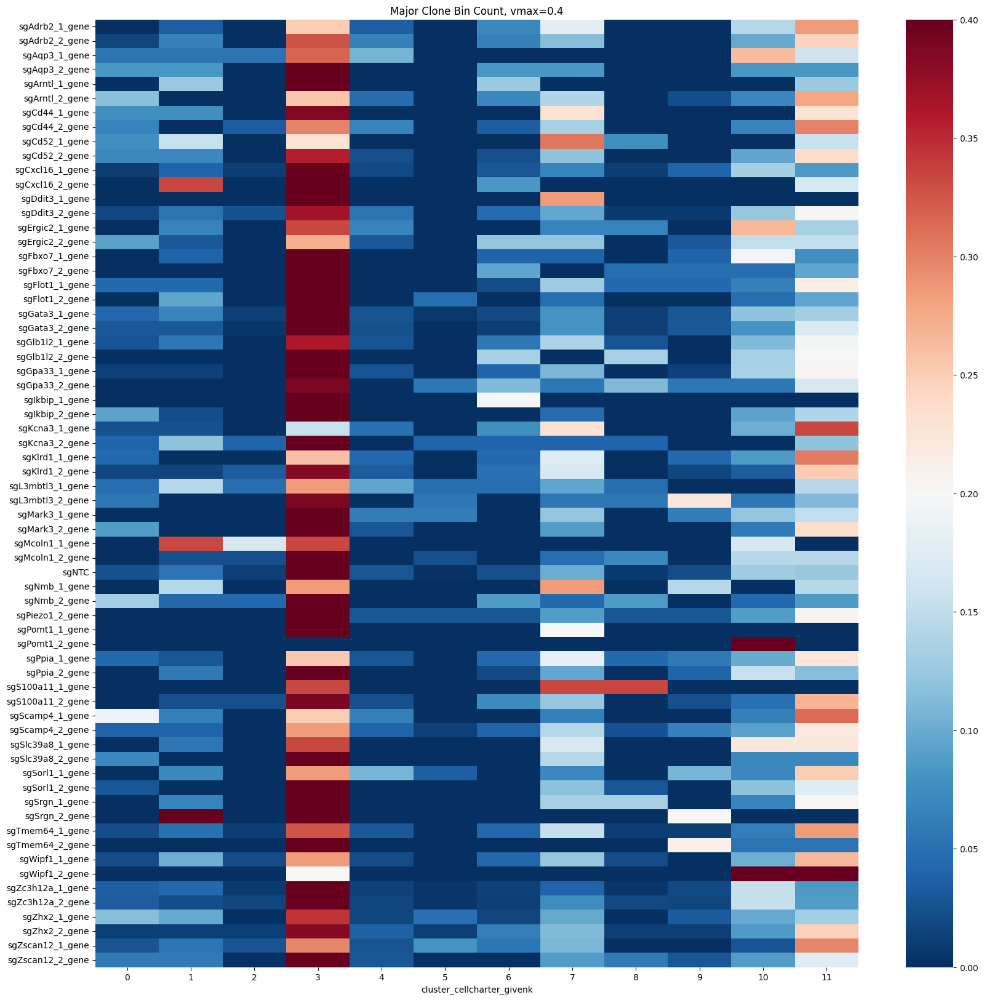

In [101]:
plt.figure(figsize=(20, 20))
sns.heatmap(proportion_df, cmap="RdBu_r", vmax=0.4)
plt.title("Major Clone Bin Count, vmax=0.4")
plt.show()

In [31]:
proportion_df[cluster] = cdata[mask.T[0].toarray()[0] & (fdata.obs["cluster_cellcharter_givenk"] == cluster).tolist()].X.sum(axis=0).tolist()

In [36]:
cdata

AnnData object with n_obs × n_vars = 118279 × 67
    obs: 'marker', 'cov'
    obsm: 'spatial'

In [37]:
fdata

AnnData object with n_obs × n_vars = 118279 × 13177
    obs: 'marker', 'n_genes', 'n_counts', '_scvi_batch', '_scvi_labels', 'cluster_cellcharter_givenk'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: '_cellcharter', '_scvi_manager_uuid', '_scvi_uuid', 'cluster_cellcharter_givenk_colors', 'log1p', 'rank_genes_groups', 'spatial_neighbors'
    obsm: 'X_cellcharter', 'X_scVI', 'spatial'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [102]:
proportion_df = {}
for cluster in np.unique(fdata.obs["cluster_cellcharter_givenk"]):
    proportion_df[cluster] = cdata[mask.T[0].toarray()[0] & (fdata.obs["cluster_cellcharter_givenk"] == cluster)].X.toarray().sum(axis=0).tolist()
proportion_df = pd.DataFrame(proportion_df)
proportion_df.index = cdata.var_names
proportion_df = proportion_df.T.fillna(0)
proportion_df

proportion_df = (proportion_df / proportion_df.sum(axis=0))
proportion_df.dropna(inplace=True)

In [68]:
proportion_df

,sgAdrb2_1_gene,sgAdrb2_2_gene,sgAqp3_1_gene,sgAqp3_2_gene,sgArntl_1_gene,sgArntl_2_gene,sgCd44_1_gene,sgCd44_2_gene,sgCd52_1_gene,sgCd52_2_gene,...,sgTmem64_1_gene,sgTmem64_2_gene,sgWipf1_1_gene,sgWipf1_2_gene,sgZc3h12a_1_gene,sgZc3h12a_2_gene,sgZhx2_1_gene,sgZhx2_2_gene,sgZscan12_1_gene,sgZscan12_2_gene
0,0.047337,0.018935,0.088235,0.116667,0.065041,0.029787,0.055794,0.014925,0.104839,0.035422,...,0.016590,0.086093,0.060932,0.082090,0.095436,0.033058,0.082677,0.030457,0.020202,0.097541
1,0.153846,0.435503,0.088235,0.111111,0.113821,0.180851,0.158798,0.088195,0.145161,0.174387,...,0.085714,0.092715,0.132616,0.097015,0.109959,0.184179,0.122047,0.167513,0.077922,0.340164
2,0.017751,0.022485,0.039216,0.044444,0.073171,0.029787,0.051502,0.008141,0.064516,0.032698,...,0.011982,0.066225,0.082437,0.059701,0.066390,0.054309,0.078740,0.027073,0.012987,0.080328
3,0.165680,0.113609,0.196078,0.205556,0.195122,0.146809,0.137339,0.065129,0.137097,0.185286,...,0.081106,0.172185,0.207885,0.149254,0.126556,0.350649,0.118110,0.152284,0.082251,0.054918
4,0.050296,0.034320,0.049020,0.050000,0.048780,0.065957,0.042918,0.033921,0.048387,0.054496,...,0.028571,0.059603,0.039427,0.059701,0.060166,0.047226,0.059055,0.055838,0.525253,0.032787
5,0.017751,0.011834,0.049020,0.016667,0.024390,0.017021,0.017167,0.009498,0.064516,0.016349,...,0.002765,0.039735,0.021505,0.022388,0.029046,0.012987,0.027559,0.010152,0.004329,0.121311
6,0.062130,0.036686,0.147059,0.083333,0.073171,0.057447,0.094421,0.028494,0.112903,0.062670,...,0.036866,0.099338,0.057348,0.104478,0.145228,0.066116,0.086614,0.054146,0.040404,0.025410
7,0.130178,0.102959,0.088235,0.138889,0.089431,0.153191,0.158798,0.063772,0.096774,0.114441,...,0.082949,0.105960,0.139785,0.119403,0.109959,0.060213,0.129921,0.126904,0.063492,0.058197
8,0.056213,0.030769,0.029412,0.022222,0.016260,0.036170,0.047210,0.546811,0.032258,0.038147,...,0.027650,0.033113,0.039427,0.029851,0.022822,0.028335,0.015748,0.052453,0.018759,0.016393
9,0.059172,0.039053,0.058824,0.011111,0.089431,0.059574,0.060086,0.027137,0.048387,0.070845,...,0.040553,0.079470,0.039427,0.067164,0.053942,0.028335,0.074803,0.067682,0.030303,0.040164


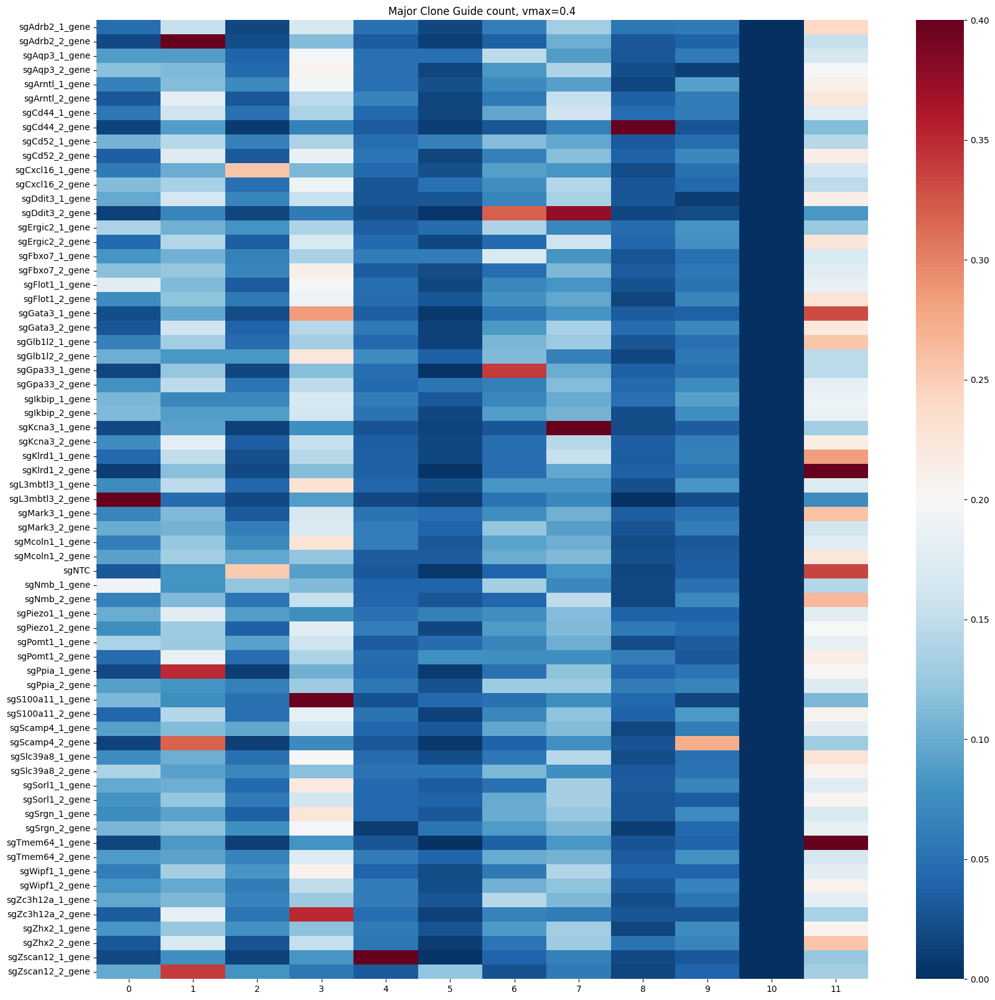

In [71]:
plt.figure(figsize=(20, 20))
sns.heatmap(proportion_df.T, cmap="RdBu_r", vmax=0.4)
plt.title("Major Clone Guide count, vmax=0.4")
plt.show()

In [10]:
from bin import load_bgi as ld

In [11]:
ddata = ld.load_bin("../20240602-T/B924.mapped.cut.gem", bin_size=20, library_id="map")

In [14]:
Fibroblasts = ["Col1a1", "Col1a2", "Col3a1","Mmp2", "Myl9", "Dcn","Fap"]
sc.tl.score_genes(fdata_2, Fibroblasts, score_name="fibro_score")

/tmp/ipykernel_42108/1836186700.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap("tab20", 34)


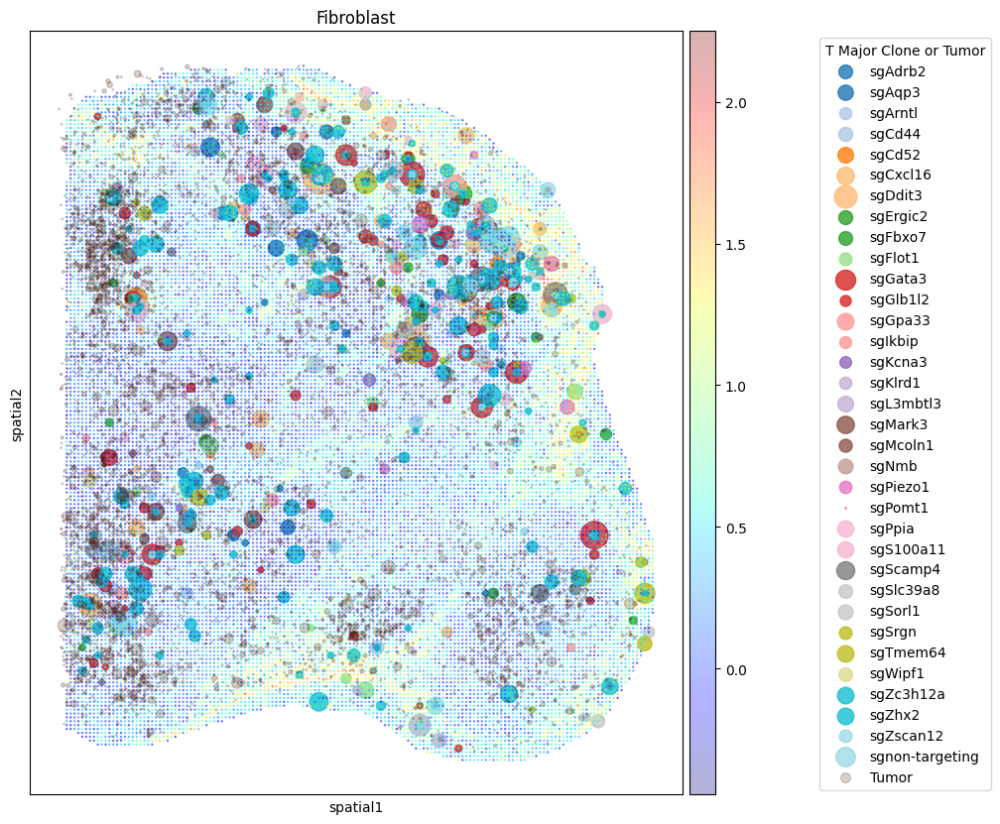

In [20]:
fig, ax = plt.subplots(figsize=(10, 10))

colors = plt.cm.get_cmap("tab20", 34)
color_map = {f"{cdata.var_names[i]}": colors(i) for i in range(34)}

for guide in cdata.var_names:
    mask = (cdata_2[:, guide].X > threshold)
    x = cdata_2[mask].obsm["spatial"][:, 0]
    y = cdata_2[mask].obsm["spatial"][:, 1]
    a = (cdata_2[mask, guide].X.flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color=color_map[guide], label=guide)

plt.legend(bbox_to_anchor=(1.05, 1), loc='best', ncol=2)
sq.pl.spatial_scatter(fdata_2, color="fibro_score", size=2, alpha=0.3, cmap="jet", shape=None, library_id="spatial", ax=ax, legend_loc=None)
x = ddata.obsm["spatial"][:, 0]
y = ddata.obsm["spatial"][:, 1]
a = ddata[:,"tdTomato"].X.toarray().flatten()
ax.scatter(x, y, s=np.square(a), alpha=0.2, color="#441100", label="Tumor")
ax.set_title("Fibroblast")
plt.legend(title='T Major Clone or Tumor', bbox_to_anchor=(1.2, 1), loc='upper left')
plt.show()

In [53]:
fdata_.obs["marker"].unique()

['3-2']
Categories (1, object): ['3-2']

In [7]:
sgs = cdata.var_names.str.split('_', n=1).str[0]
sgs_grouped = pd.DataFrame(cdata.X.toarray(), columns=cdata.var_names)
sgs_grouped = sgs_grouped.groupby(sgs, axis=1).sum()
sgdata = ad.AnnData(sgs_grouped, obs=cdata.obs, var=pd.DataFrame(index=sgs_grouped.columns))
sgdata.obsm['spatial'] = cdata.obsm['spatial']
gdata = sgdata.copy()

/tmp/ipykernel_58142/3131625080.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sgs_grouped = sgs_grouped.groupby(sgs, axis=1).sum()


/tmp/ipykernel_37784/2357177129.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap("tab20", 67)
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/w

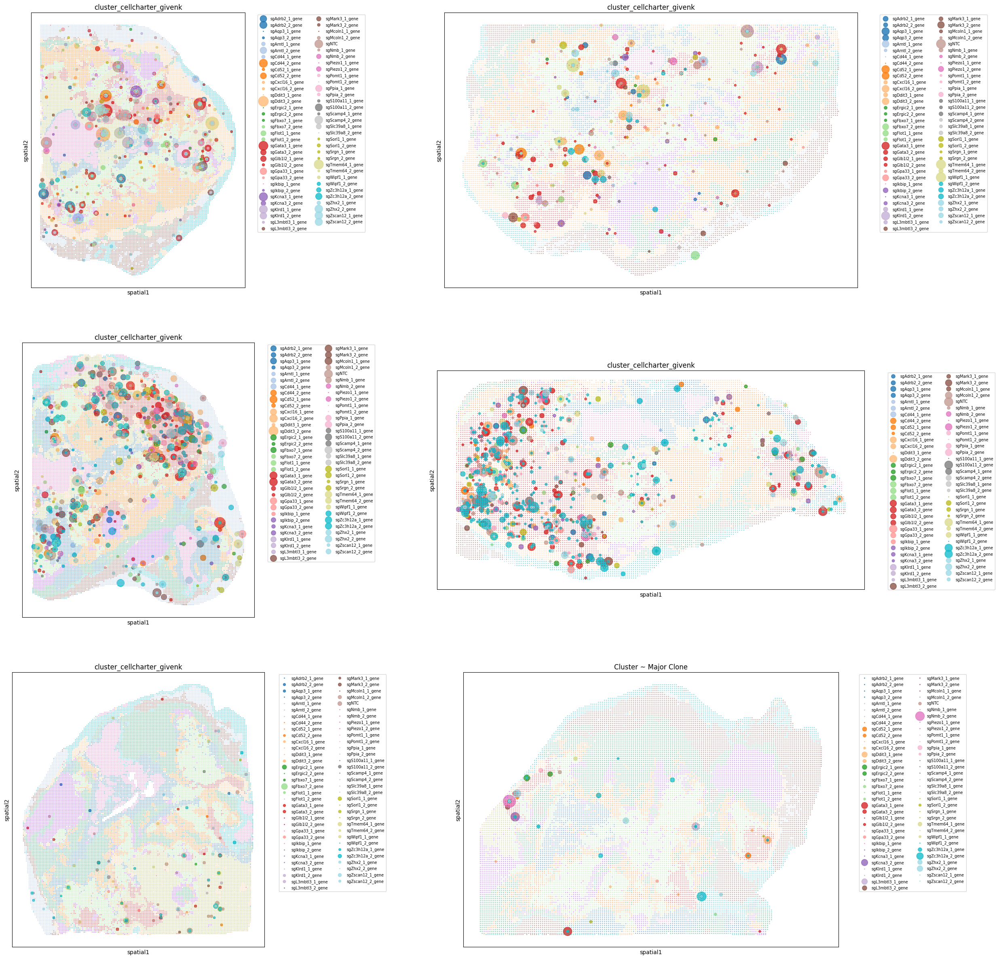

In [66]:
fig, axs = plt.subplots(3, 2, figsize=(30, 30))

colors = plt.cm.get_cmap("tab20", 67)
color_map = {f"{cdata.var_names[i]}": colors(i) for i in range(67)}

for idx, marker in enumerate(["1-1", "1-2", "2-1", "2-2", "3-1", "3-2"]):
    ix = idx // 2
    iy = idx % 2
    ax = axs[ix, iy]
    cdata_ = cdata[cdata.obs["marker"] == marker]
    fdata_ = fdata[fdata.obs["marker"] == marker]
    for guide in cdata.var_names:
        mask = (cdata_[:, guide].X > threshold)
        x = cdata_[mask].obsm["spatial"][:, 0]
        y = cdata_[mask].obsm["spatial"][:, 1]
        a = (cdata_[mask, guide].X.toarray().flatten()).tolist()
        ax.scatter(x, y, s=a, alpha=0.8, color=color_map[guide], label=guide)
    sq.pl.spatial_scatter(fdata_, color="cluster_cellcharter_givenk", size=2, alpha=0.3, shape=None, library_id="spatial", ax=ax, legend_loc=None)
    ax.legend(bbox_to_anchor=(1.05, 1), loc='best', ncol=2, fontsize="x-small")

ax.set_title("Cluster ~ Major Clone")
plt.show()

/tmp/ipykernel_37784/2678959321.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap("tab20", 34)
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]


/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py

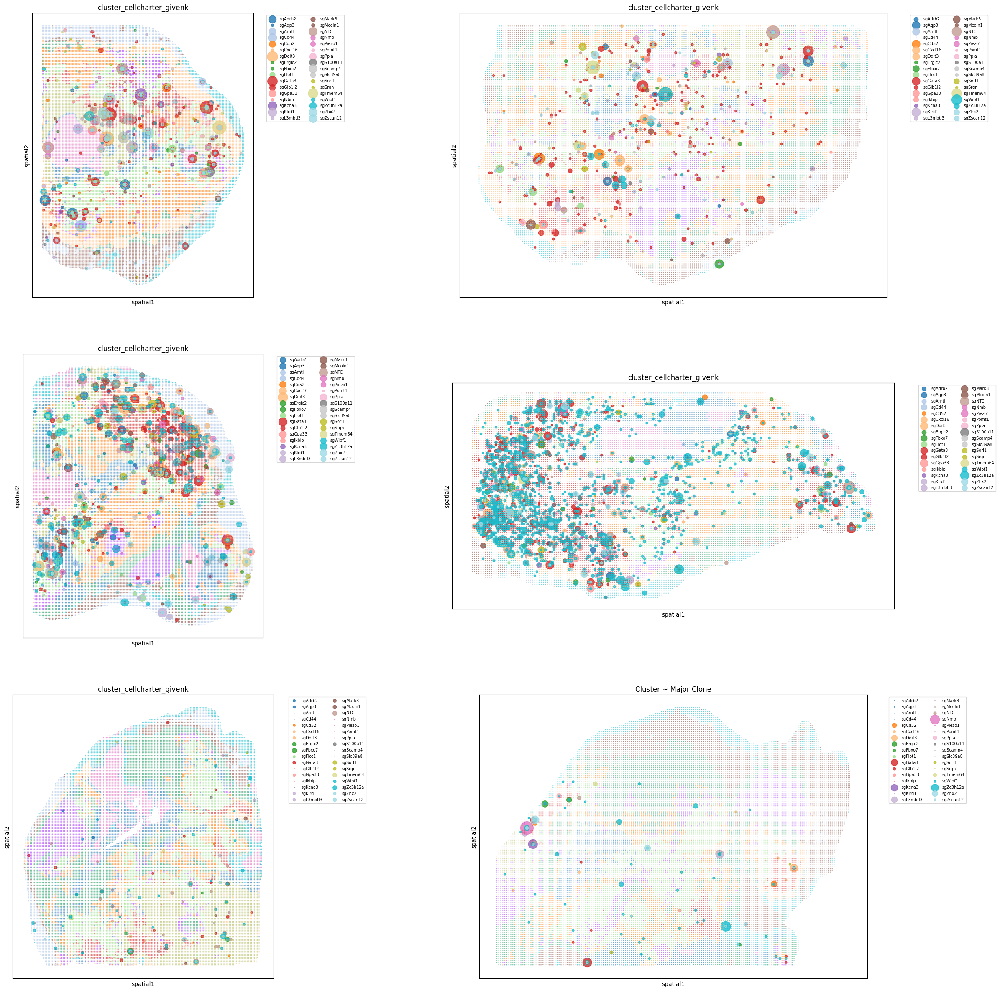

In [64]:
fig, axs = plt.subplots(3, 2, figsize=(30, 30))

colors = plt.cm.get_cmap("tab20", 34)
color_map = {f"{gdata.var_names[i]}": colors(i) for i in range(34)}

for idx, marker in enumerate(["1-1", "1-2", "2-1", "2-2", "3-1", "3-2"]):
    ix = idx // 2
    iy = idx % 2
    ax = axs[ix, iy]
    cdata_ = gdata[gdata.obs["marker"] == marker]
    fdata_ = fdata[fdata.obs["marker"] == marker]
    for guide in gdata.var_names:
        mask = (cdata_[:, guide].X > threshold)
        x = cdata_[mask].obsm["spatial"][:, 0]
        y = cdata_[mask].obsm["spatial"][:, 1]
        a = (cdata_[mask, guide].X.toarray().flatten()).tolist()
        ax.scatter(x, y, s=a, alpha=0.8, color=color_map[guide], label=guide)
    sq.pl.spatial_scatter(fdata_, color="cluster_cellcharter_givenk", size=2, alpha=0.3, shape=None, library_id="spatial", ax=ax, legend_loc=None)
    ax.legend(bbox_to_anchor=(1.05, 1), loc='best', ncol=2, fontsize="x-small")

ax.set_title("Cluster ~ Major Clone")
plt.show()

In [105]:
gdata.obs["cluster"] = fdata.obs["cluster_cellcharter_givenk"].tolist()

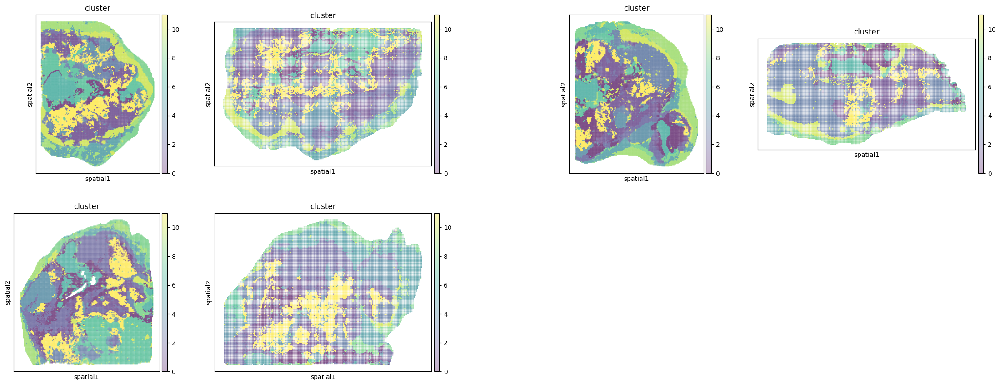

In [106]:
sq.pl.spatial_scatter(gdata, color="cluster", size=2, alpha=0.3, shape=None, library_key="marker", legend_loc=None)

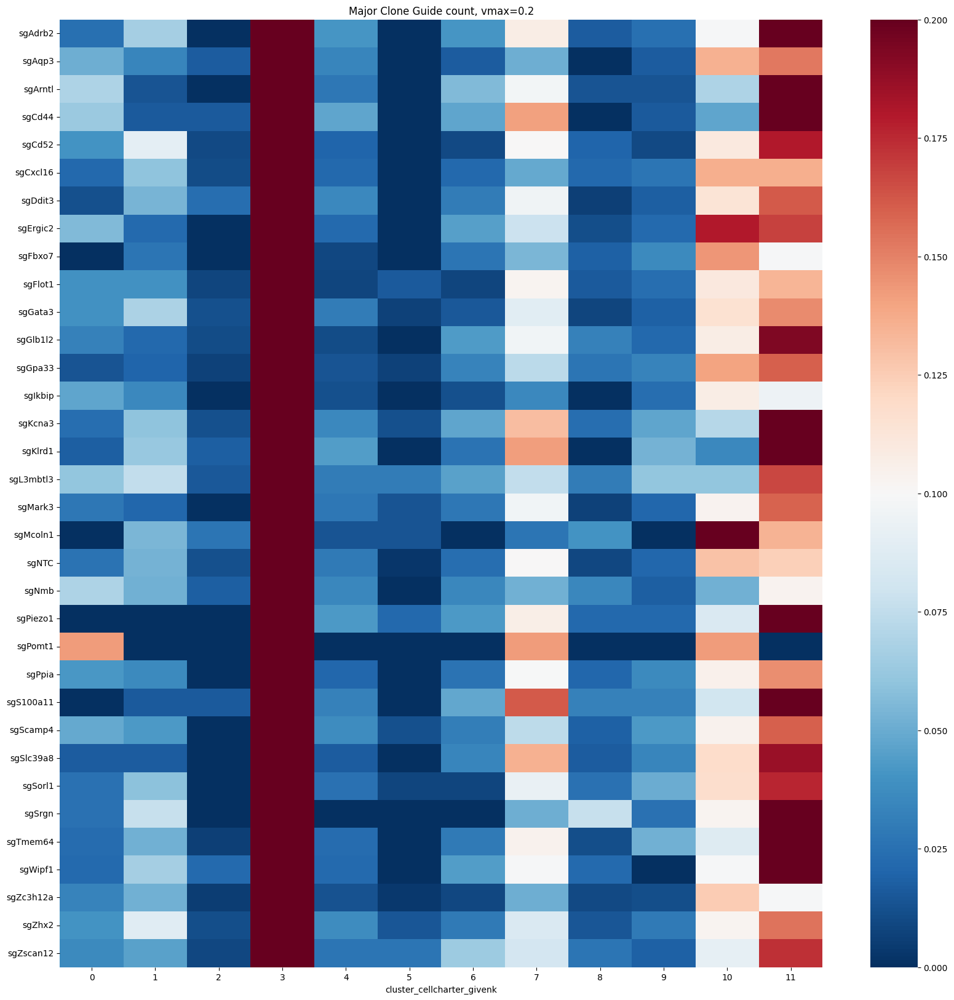

In [109]:
proportion_df = {}
for guide in gdata.var_names:
    mask = (gdata[:, guide].X > threshold)
    proportion_df[guide] = (fdata[mask].obs["cluster_cellcharter_givenk"]).value_counts()
proportion_df = pd.DataFrame(proportion_df)
proportion_df = proportion_df.T.fillna(0)

proportion_df = (proportion_df.T / proportion_df.T.sum(axis=0)).T
proportion_df.dropna(inplace=True)

plt.figure(figsize=(20, 20))
sns.heatmap(proportion_df, cmap="RdBu_r", vmax=0.2)
plt.title("Major Clone Guide count, vmax=0.2")
plt.show()

# Cd44 Specific

/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:2

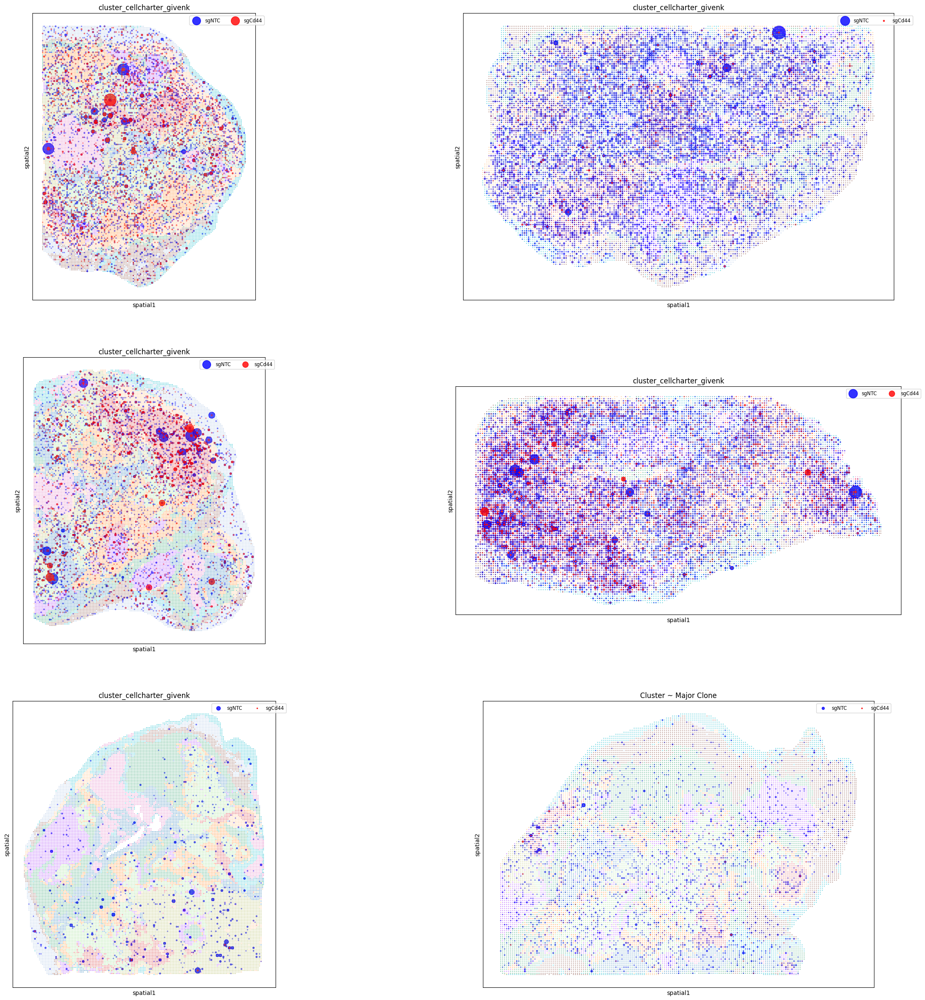

In [11]:
fig, axs = plt.subplots(3, 2, figsize=(30, 30))

for idx, marker in enumerate(["1-1", "1-2", "2-1", "2-2", "3-1", "3-2"]):
    ix = idx // 2
    iy = idx % 2
    ax = axs[ix, iy]
    cdata_ = gdata[gdata.obs["marker"] == marker]
    fdata_ = fdata[fdata.obs["marker"] == marker]
    
    mask = (cdata_[:, "sgNTC"].X > threshold)
    x = cdata_.obsm["spatial"][:, 0]
    y = cdata_.obsm["spatial"][:, 1]
    a = (cdata_[:, "sgNTC"].X.toarray().flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color="Blue", label="sgNTC")
    
    mask = (cdata_[:, "sgCd44"].X > threshold)
    x = cdata_.obsm["spatial"][:, 0]
    y = cdata_.obsm["spatial"][:, 1]
    a = (cdata_[:, "sgCd44"].X.toarray().flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color="Red", label="sgCd44")

    sq.pl.spatial_scatter(fdata_, color="cluster_cellcharter_givenk", size=2, alpha=0.3, shape=None, library_id="spatial", ax=ax, legend_loc=None)
    ax.legend(bbox_to_anchor=(1.05, 1), loc='best', ncol=2, fontsize="small")

ax.set_title("Cluster ~ Major Clone")
plt.show()

/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:2

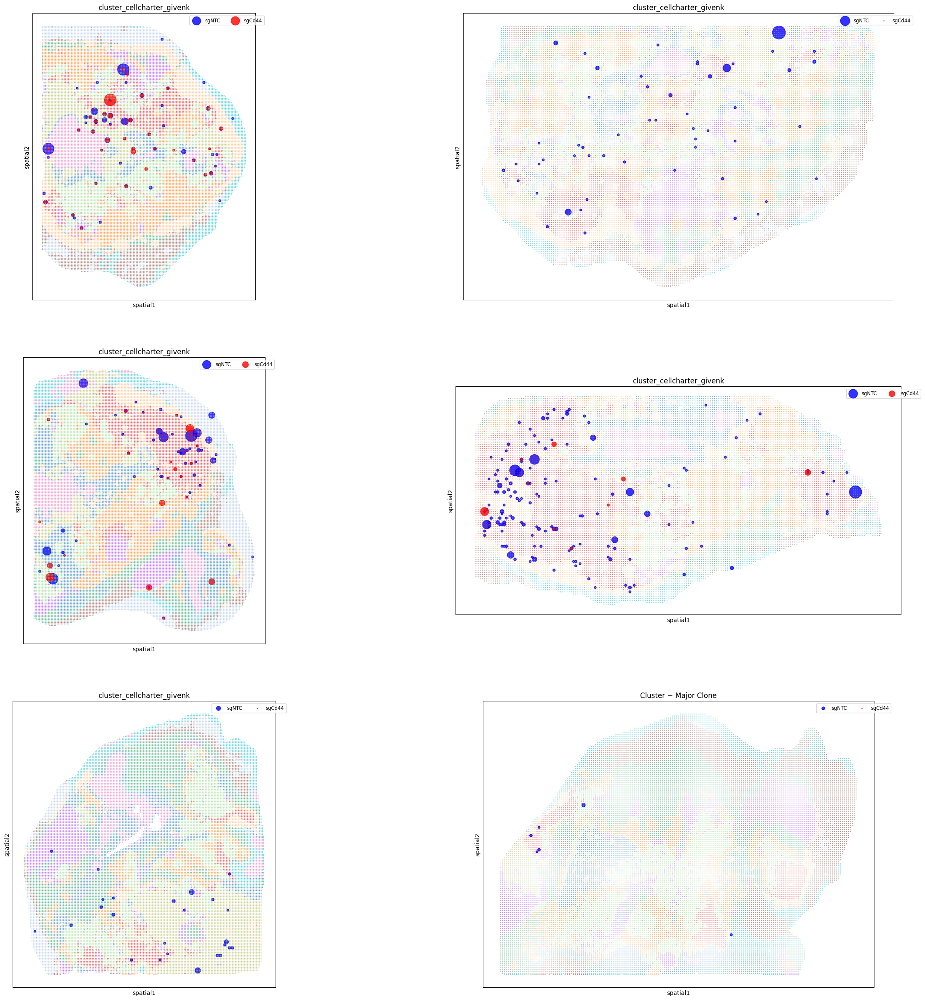

In [10]:
fig, axs = plt.subplots(3, 2, figsize=(30, 30))

for idx, marker in enumerate(["1-1", "1-2", "2-1", "2-2", "3-1", "3-2"]):
    ix = idx // 2
    iy = idx % 2
    ax = axs[ix, iy]
    cdata_ = gdata[gdata.obs["marker"] == marker]
    fdata_ = fdata[fdata.obs["marker"] == marker]
    
    mask = (cdata_[:, "sgNTC"].X > threshold)
    x = cdata_[mask].obsm["spatial"][:, 0]
    y = cdata_[mask].obsm["spatial"][:, 1]
    a = (cdata_[mask, "sgNTC"].X.toarray().flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color="Blue", label="sgNTC")
    
    mask = (cdata_[:, "sgCd44"].X > threshold)
    x = cdata_[mask].obsm["spatial"][:, 0]
    y = cdata_[mask].obsm["spatial"][:, 1]
    a = (cdata_[mask, "sgCd44"].X.toarray().flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color="Red", label="sgCd44")

    sq.pl.spatial_scatter(fdata_, color="cluster_cellcharter_givenk", size=2, alpha=0.3, shape=None, library_id="spatial", ax=ax, legend_loc=None)
    ax.legend(bbox_to_anchor=(1.05, 1), loc='best', ncol=2, fontsize="small")

ax.set_title("Cluster ~ Major Clone")
plt.show()

# sgGata3 Control

/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:2

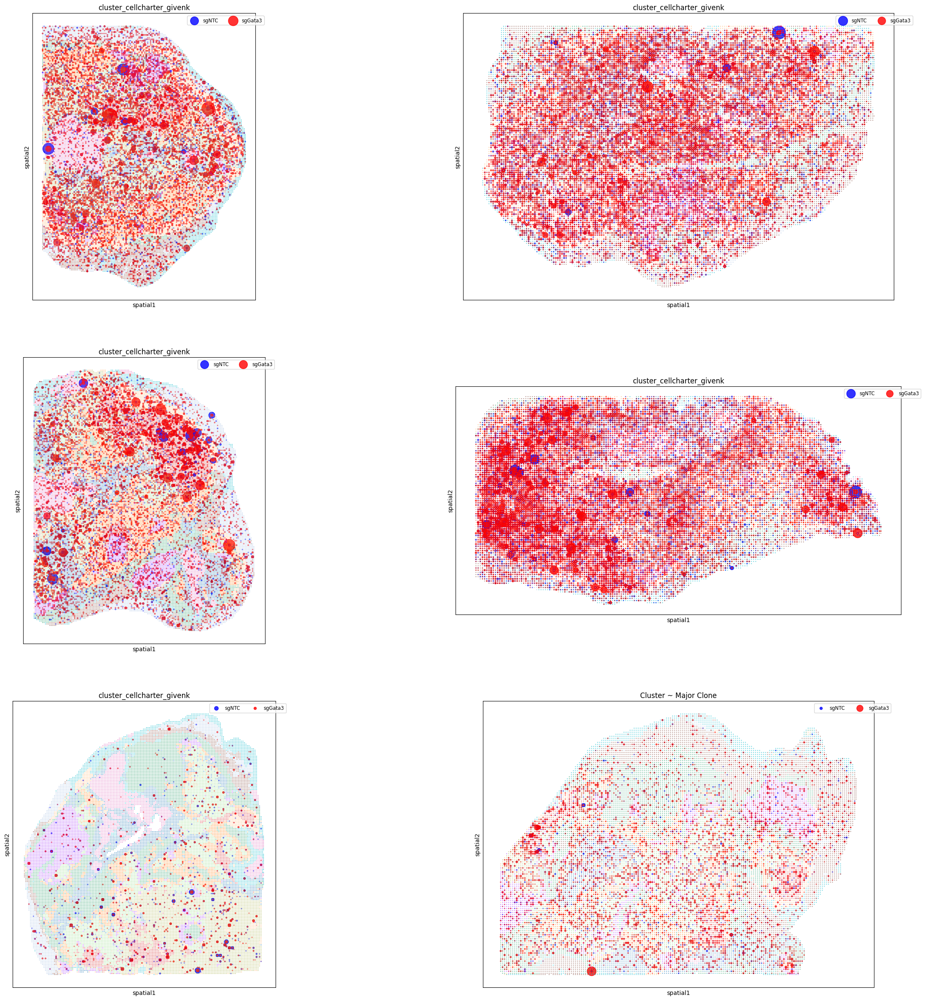

In [12]:
fig, axs = plt.subplots(3, 2, figsize=(30, 30))

for idx, marker in enumerate(["1-1", "1-2", "2-1", "2-2", "3-1", "3-2"]):
    ix = idx // 2
    iy = idx % 2
    ax = axs[ix, iy]
    cdata_ = gdata[gdata.obs["marker"] == marker]
    fdata_ = fdata[fdata.obs["marker"] == marker]
    
    mask = (cdata_[:, "sgNTC"].X > threshold)
    x = cdata_.obsm["spatial"][:, 0]
    y = cdata_.obsm["spatial"][:, 1]
    a = (cdata_[:, "sgNTC"].X.toarray().flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color="Blue", label="sgNTC")
    
    mask = (cdata_[:, "sgGata3"].X > threshold)
    x = cdata_.obsm["spatial"][:, 0]
    y = cdata_.obsm["spatial"][:, 1]
    a = (cdata_[:, "sgGata3"].X.toarray().flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color="Red", label="sgGata3")

    sq.pl.spatial_scatter(fdata_, color="cluster_cellcharter_givenk", size=2, alpha=0.3, shape=None, library_id="spatial", ax=ax, legend_loc=None)
    ax.legend(bbox_to_anchor=(1.05, 1), loc='best', ncol=2, fontsize="small")

ax.set_title("Cluster ~ Major Clone")
plt.show()

/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:25: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/squidpy/pl/_color_utils.py:2

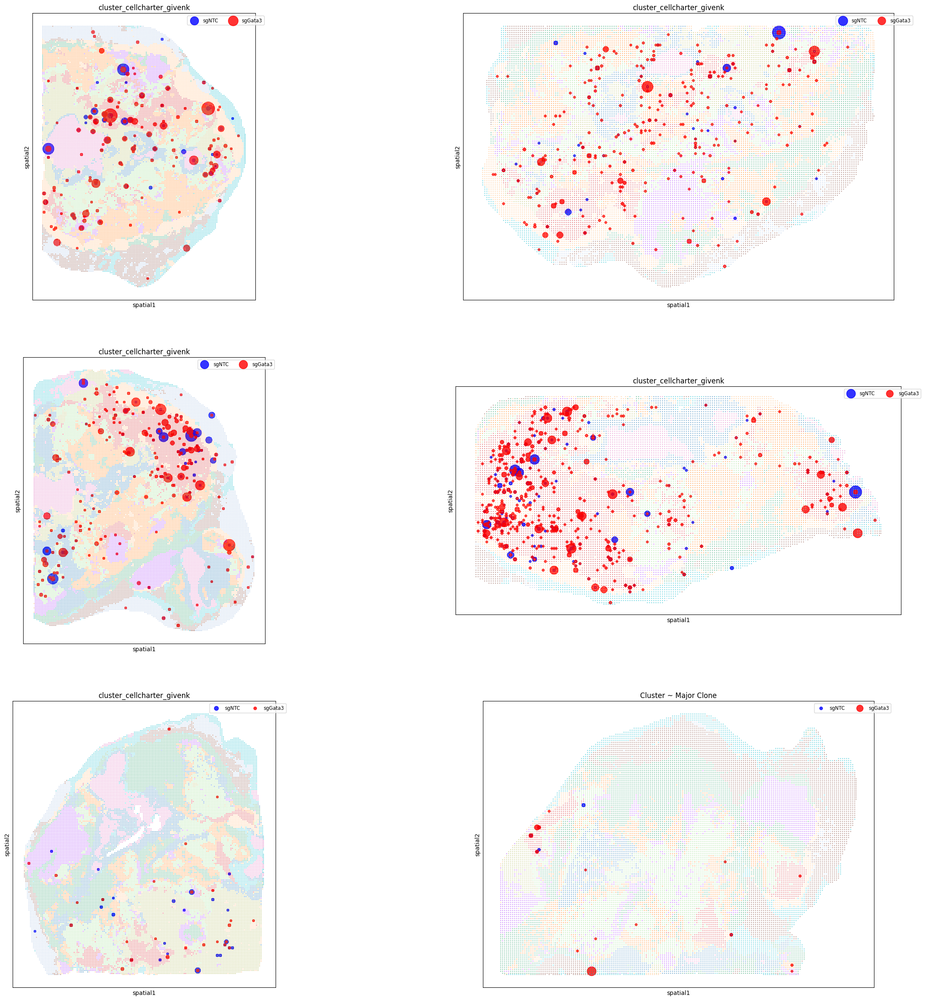

In [13]:
fig, axs = plt.subplots(3, 2, figsize=(30, 30))

for idx, marker in enumerate(["1-1", "1-2", "2-1", "2-2", "3-1", "3-2"]):
    ix = idx // 2
    iy = idx % 2
    ax = axs[ix, iy]
    cdata_ = gdata[gdata.obs["marker"] == marker]
    fdata_ = fdata[fdata.obs["marker"] == marker]
    
    mask = (cdata_[:, "sgNTC"].X > threshold)
    x = cdata_[mask].obsm["spatial"][:, 0]
    y = cdata_[mask].obsm["spatial"][:, 1]
    a = (cdata_[mask, "sgNTC"].X.toarray().flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color="Blue", label="sgNTC")
    
    mask = (cdata_[:, "sgGata3"].X > threshold)
    x = cdata_[mask].obsm["spatial"][:, 0]
    y = cdata_[mask].obsm["spatial"][:, 1]
    a = (cdata_[mask, "sgGata3"].X.toarray().flatten()).tolist()
    ax.scatter(x, y, s=a, alpha=0.8, color="Red", label="sgGata3")

    sq.pl.spatial_scatter(fdata_, color="cluster_cellcharter_givenk", size=2, alpha=0.3, shape=None, library_id="spatial", ax=ax, legend_loc=None)
    ax.legend(bbox_to_anchor=(1.05, 1), loc='best', ncol=2, fontsize="small")

ax.set_title("Cluster ~ Major Clone")
plt.show()